<h1> Programming for Physics <br> Lecture 13: Planetary Motion and Three Body Problem </h1>
<a target="_blank" href="https://colab.research.google.com/github/slxuphys/tamu_phys_150/blob/master/lecture/lecture%2014%202D_motion.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>
   

# Recap


## motion in 1D

###  constant velocity

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/motion_constant_v.png?raw=true' style='height:300px' height=300>

---

### constant acceleration

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/motion_constant_v.png?raw=true' style='height:300px' height=300>

---

### varying acceleration

<div style='display:flex;align-items:center'>

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/hooke.png?raw=true' style='height:300px' height=300>
<div>

__Hooke's Law__
The force (F) needed to extend or compress a spring by some distance (x) scales linearly with respect to that distance.

$$ F = - k x$$ 

Then from the Newton's second law, we get the acceleration,
$$
a = \frac{F}{m} = -\frac{k}{m} x
$$

</div>
</div>

## simulate the motion based on iteration (Euler method)

> __The key idea for simulating motion using programming is to break down the continuous motion into discrete time steps with small time increment $\Delta t$. This is also the idea behind calculus.__

In other words, computer simulates motion __step by step__. The simulation becomes more accurate but also more costly as the number of step increases.

With the initial condition and the update rule, one can predict the motion for arbitrarily long time.

To make the notation consistent with motion in higher dimensions, let us now use $r$ instead of $x$ for the position.

\begin{equation}
\color{red}{a_{n} = f_a(r_{n}, v_{n}, t_{n}) }
\end{equation}


\begin{equation}
\begin{aligned}
t_{n+1} &= t_{n} + \Delta t \\
v_{n+1} &= v_{n} + a_n \Delta t\\
r_{n+1} &= r_{n} + v_{n+1} \Delta t \\
\end{aligned}
\end{equation}

- simplest discrete method to simulate continuous motion. 

- $f_a (r, v, t)$ return the acceleration based the position, velocity and time.
    - motion with constant velocity: $f_a(r,v,t)=0$
    - motion with constant acceleration $a$: $f_a(r,v,t) = a$
    - spring-mass motion: $f_a(r,v,t) = -\frac{k}{m} r$
    - ...

- Once, the initial conditions ($x_0$, $v_0$) are given, we can obtain the position and velocity iteratively.

- __Not exact__. only accurate when $\Delta t \rightarrow 0$
    
    In practice, we need to make sure the result does not change as we increase `num_step` while fixing `t_max`.
    

- not the only way; other methods (more complicated) with better precision are available. You will learn more in computational physics.


## Ball Class and Motion function

In [9]:
import numpy as np 
import matplotlib.pyplot as plt

class Ball:
    def __init__(self,r=0,v=0,t=0):
        self.r=np.array(r)
        self.v=np.array(v)
        self.t=t
        self.time_list=[]
        self.pos_list=[]
    def move(self,dt):
        self. a = np.array(self.a) # convert the acceleration to a numpy array for vector sum
        self.t=self.t+dt
        self.v=self.v+self.a*dt
        self.r=self.r+self.v*dt
    def record(self): #record the current position and time to the lists
        self.time_list.append(self.t)
        self.pos_list.append(self.r)
    def clear(self): #clear the history
        self.time_list=[]
        self.pos_list=[]
    def plot(self): #draw the path
        plt.plot(self.time_list,self.pos_list)
        plt.xlabel('time')
        plt.ylabel('position')

def motion(t_max,num_step,ball,f_a=lambda r,v,t:0):
    '''
    a function that takes a ball object as an input
    it simulates the motion
    the acceleration is given by lambda function fa
    '''
    dt = t_max/num_step
    for i_step in range(num_step):
        ball.a=f_a(ball.r,ball.v,ball.t)
        ball.move(dt)
        ball.record()

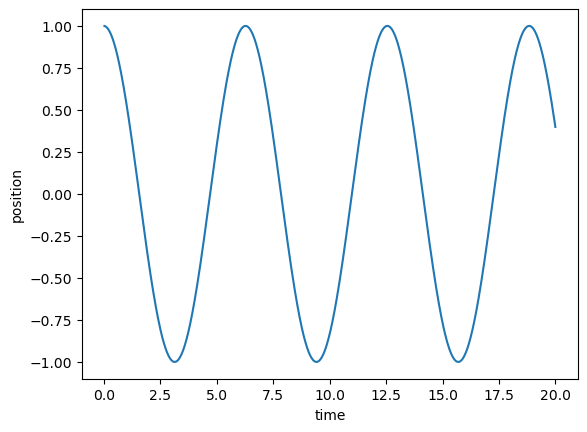

In [10]:
b = Ball(r=1, v=0)
motion(t_max = 20, num_step = 1000, ball = b, f_a = lambda r, v, t: -r)
b.plot()

You can also put the class and function in a module file and import them.

---

# Motion in Higher Dimensions

## Euler method

\begin{equation}
\color{red}{\vec{a}_{n}= \vec{f}_a(\vec{r}_{n}, \vec{v}_{n}, t_{n}) }
\end{equation}

\begin{equation}
\begin{aligned}
t_{n+1} &= t_{n} + \Delta t \\
\vec{v}_{n+1} &= \vec{v}_{n} + \vec{a}_n \Delta t\\
\vec{r}_{n+1} &= \vec{r}_{n} + \vec{v}_{n+1} \Delta t \\
\end{aligned}
\end{equation}

- The position, velocity and accelerations are now vectors, for instance $\vec r = (x, y, z)$, $\vec v = (v_x, v_y, v_z)$ and $\vec a = (a_x, a_y, a_z)$. The function $\vec f_a$ also returns a vector as the acceleration.






## Summary of steps

1. Specify the initial position and velocity of the ball. (Using Ball class)
2. Specify the acceleration functions and use it as the argument of the motion function.
3. Iterate the Euler method. Consider the boundary if there is one.
4. Record the positions at each iteration.
5. Visualization - Plots and animations

## Example: Projectile Motion
Simulate the projectile motion of a ball with the same initial speed $v$ but different initial launching angles $\theta$.

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/projectile.png?raw=true' style='height:400px' height=400>


- step 1: determine the initial condition:
$$
\vec r_0 = (0 ,0)
$$

$$
\vec v_0 = (v\cos \theta, v\sin \theta)
$$

- step 2: determine the acceleration. Projectile motion is a motion with constant acceleration. The only acceleration here is from the gravity in the vertical direction.

$$
\vec a = (0, -g)
$$



In [11]:
v = 6
theta = np.pi/6 # (30 degree)
t_max = 1
num_step = 1000
dt = t_max/num_step
b = Ball(r=(0, 0), v = (v*np.cos(theta), v*np.sin(theta)) )

for i in range(num_step):
    b.a = (0, -10)
    b.move(dt)
    if b.r[1]<0:
        b.v[1] = -b.v[1]
        b.r[1] = -b.r[1]
    b.record()

In [12]:
b.pos_list

[array([0.00519615, 0.00299   ]),
 array([0.0103923, 0.00597  ]),
 array([0.01558846, 0.00894   ]),
 array([0.02078461, 0.0119    ]),
 array([0.02598076, 0.01485   ]),
 array([0.03117691, 0.01779   ]),
 array([0.03637307, 0.02072   ]),
 array([0.04156922, 0.02364   ]),
 array([0.04676537, 0.02655   ]),
 array([0.05196152, 0.02945   ]),
 array([0.05715768, 0.03234   ]),
 array([0.06235383, 0.03522   ]),
 array([0.06754998, 0.03809   ]),
 array([0.07274613, 0.04095   ]),
 array([0.07794229, 0.0438    ]),
 array([0.08313844, 0.04664   ]),
 array([0.08833459, 0.04947   ]),
 array([0.09353074, 0.05229   ]),
 array([0.0987269, 0.0551   ]),
 array([0.10392305, 0.0579    ]),
 array([0.1091192, 0.06069  ]),
 array([0.11431535, 0.06347   ]),
 array([0.11951151, 0.06624   ]),
 array([0.12470766, 0.069     ]),
 array([0.12990381, 0.07175   ]),
 array([0.13509996, 0.07449   ]),
 array([0.14029612, 0.07722   ]),
 array([0.14549227, 0.07994   ]),
 array([0.15068842, 0.08265   ]),
 array([0.15588457, 

After the simulation, we will get

|$t$|$x$|$y$|
|-|-|-|
|$t_0$|$x_0$|$y_0$|
|$t_1$|$x_1$|$y_1$|
|$t_2$|$x_2$|$y_2$|
|$t_3$|$x_3$|$y_3$|
|$\cdots$|$\cdots$|$\cdots$|

The goal is to plot the coordinate $(x,y)$ at each time to obtain the trajectory of the ball

(-0.2543516610914857,
 5.455700236220745,
 -0.02257499999998687,
 0.4740749999999803)

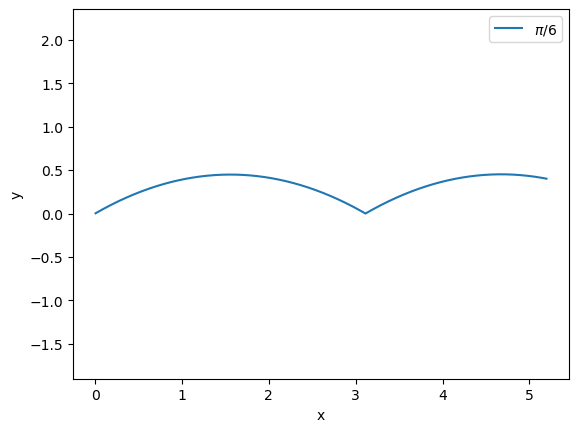

In [13]:
b.pos_list = np.array(b.pos_list) #convert the post_list in a 2d array. The first column is the x coordinate and the second is the y coordinate
b.pos_x = b.pos_list[:,0] #obtain the x coordinate
b.pos_y = b.pos_list[:,1] #obtain the y coordinate
fig, ax = plt.subplots()
plt.plot(b.pos_x, b.pos_y, label =r'$\pi/6$')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
ax.axis('equal')

### wrap the code into a `projectile_motion` function

In [14]:
def projectile_motion(t_max, num_step, v, theta):
    b = Ball(r=(0, 0), v = (v*np.cos(theta), v*np.sin(theta)) )
    dt = t_max/num_step
    for i in range(num_step):
        b.a = (0, -10)
        b.move(dt)
        if b.r[1]<0:
            b.v[1] = -b.v[1]
            b.r[1] = -b.r[1]
        b.record()
    #b.max_step = len(b.pos_list)
    b.pos_list = np.array(b.pos_list) #convert the post_list in a 2d array. The first column is the x coordinate and the second is the y coordinate
    b.pos_x = b.pos_list[:,0] #obtain the x coordinate
    b.pos_y = b.pos_list[:,1] #obtain the y coordinate
    return b #return the ball object for later reference
    


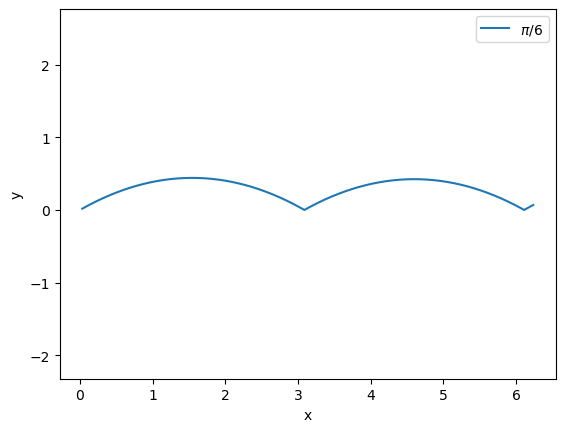

In [15]:
b = projectile_motion(t_max =1.2 , num_step =200, v=6, theta = np.pi/6)
b.trajectory = plt.plot(b.pos_x, b.pos_y, label = r'$\pi/6$')[0]
#set the optional label argument to label, which specifies the label to be shown in the legend.
#plt.plot return a list of line objects being plotted. Here only a singe line is plotted, so we use list index [0] to get the line object and assign it to the variable b's attribute for later reference.
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.legend() #show the legend

### different launch angles

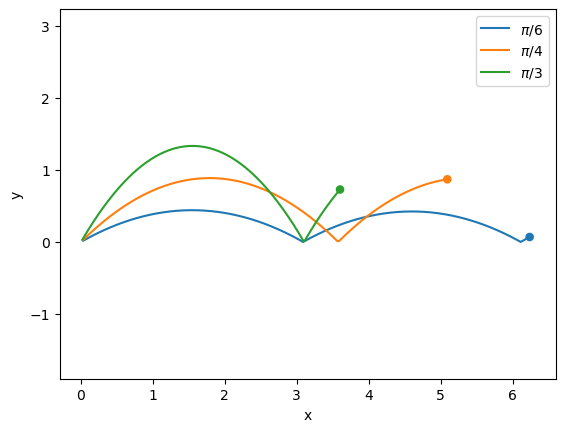

In [16]:
fig, ax  = plt.subplots() #create a blank figure

b1 = projectile_motion(t_max =1.2 , num_step =200, v=6, theta = np.pi/6)
b1.trajectory = plt.plot(b1.pos_x, b1.pos_y, label = r'$\pi/6$')[0]
b1.shape = plt.Circle(b1.pos_list[-1,:], radius=0.05, color = b1.trajectory.get_color()) #make sure that the color of the circular patch matches that of the line
ax.add_patch(b1.shape)

b2 = projectile_motion(t_max =1.2 , num_step =200, v=6, theta = np.pi/4)
b2.trajectory = plt.plot(b2.pos_x, b2.pos_y, label = r'$\pi/4$')[0]
b2.shape = plt.Circle(b2.pos_list[-1,:], radius=0.05, color = b2.trajectory.get_color()) #make sure that the color of the circular patch matches that of the line
ax.add_patch(b2.shape)

b3 = projectile_motion(t_max =1.2 , num_step =200, v=6, theta = np.pi/3)
b3.trajectory = plt.plot(b3.pos_x, b3.pos_y, label = r'$\pi/3$')[0]
b3.shape = plt.Circle(b3.pos_list[-1,:], radius=0.05, color = b3.trajectory.get_color()) #make sure that the color of the circular patch matches that of the line
ax.add_patch(b3.shape)

#plt.plot return a list of line objects being plotted. Here only a singe line is plotted, so we use list index [0] to get the line object and assign it to the variable b's attribute for later reference.
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.legend() #show the legend


### update the figure in place

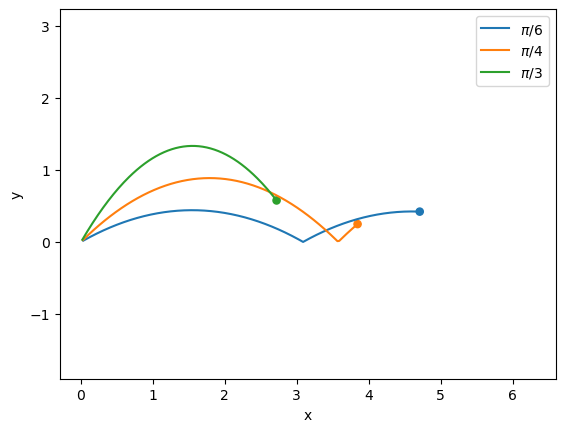

In [17]:
step = 150

b1.trajectory.set_data(b1.pos_x[:step], b1.pos_y[:step]) #update the line
b1.shape.set_center((b1.pos_x[step], b1.pos_y[step])) #update the circle

b2.trajectory.set_data(b2.pos_x[:step], b2.pos_y[:step]) #update the line
b2.shape.set_center((b2.pos_x[step], b2.pos_y[step])) #update the circle

b3.trajectory.set_data(b3.pos_x[:step], b3.pos_y[:step]) #update the line
b3.shape.set_center((b3.pos_x[step], b3.pos_y[step])) #update the circle

fig




### Animation



In [18]:
def draw_frame(frame_index):
    step = frame_index
    b1.trajectory.set_data(b1.pos_x[:step], b1.pos_y[:step]) #update the line
    b1.shape.set_center((b1.pos_x[step], b1.pos_y[step])) #update the circle
    
    b2.trajectory.set_data(b2.pos_x[:step], b2.pos_y[:step]) #update the line
    b2.shape.set_center((b2.pos_x[step], b2.pos_y[step])) #update the circle
    
    b3.trajectory.set_data(b3.pos_x[:step], b3.pos_y[:step]) #update the line
    b3.shape.set_center((b3.pos_x[step], b3.pos_y[step])) #update the circle


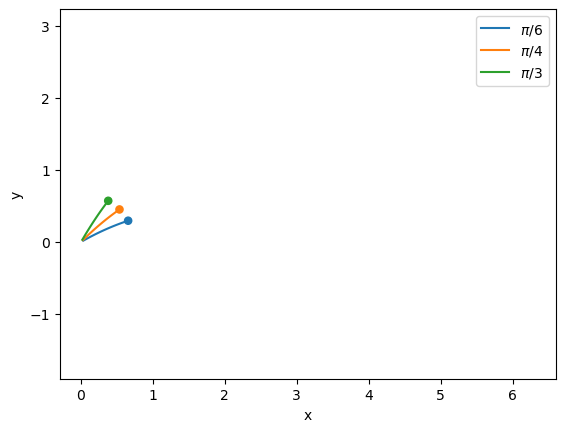

In [19]:
draw_frame(frame_index=20)
fig

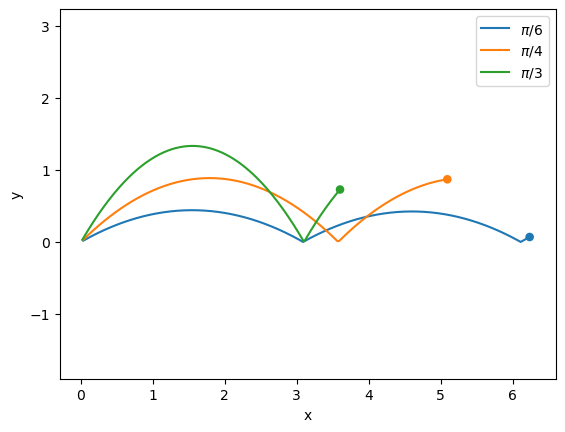

In [20]:
draw_frame(frame_index=199)
fig

In [21]:
import IPython
import matplotlib.animation as animation
anim = animation.FuncAnimation(fig, draw_frame, frames=200, interval=20)
IPython.display.HTML(anim.to_jshtml())

---

## Planetary motion
![image.png](https://sgp1.digitaloceanspaces.com/awe/awedmin/__sized__/post_headers/Keplers_laws-thumbnail-1000x525-70.jpg)

### Central Force Problem

The force acting on the object is directed along the line joining the object and the origin.

The strength of the force only depends on the distance. Many forces in our universe appear as central forces

For example, the gravitational force between Sun and Earth, and the electric force between two charges.


<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/central_force.png?raw=true' style='height:600px' height=600>


### Euler Method for center force problem

\begin{equation}
\color{red}{\vec{a}_{n} =\frac{1}{m} \frac{f(r)}{r}\vec r}
\end{equation}

\begin{equation}
\begin{aligned}
t_{n+1} &= t_{n} + \Delta t \\
\vec{v}_{n+1} &= \vec{v}_{n} + \vec{a}_n \Delta t\\
\vec{r}_{n+1} &= \vec{r}_{n} + \vec{v}_{n+1} \Delta t \\
\end{aligned}
\end{equation}

For a vector $\vec r$ in the form of a numpy array, we can calculate its norm (length) $r$ using np.linalg.norm()

### Kepler Problem

The magnitude of the force is proportional to the inverse squared distance

- Gravity Force

- Coulomb Force

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/kepler_problem.png?raw=true' style='height:500px'  height=500>


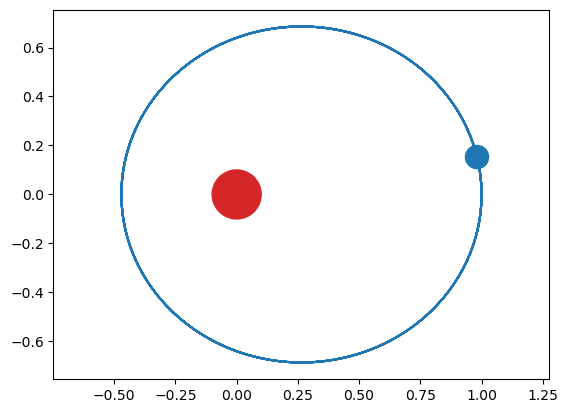

In [23]:
planet = Ball(r=(1,0), v=(0,0.8))
motion(t_max=20, num_step=40000, ball=planet, f_a=lambda r,v,t:-r/np.linalg.norm(r)**(3))

planet.pos_list = np.array(planet.pos_list)
planet.pos_x = planet.pos_list[:,0]
planet.pos_y = planet.pos_list[:,1]
planet.shape = plt.Circle((planet.pos_x[-1], planet.pos_y[-1]), radius=0.05)
fig, ax = plt.subplots()
plt.plot(planet.pos_x, planet.pos_y)
plt.axis('equal')

ax.add_patch(planet.shape)

star = Ball(r=(0,0), v=(0,0))
star.shape = plt.Circle((0,0), radius=0.1, color='tab:red')
ax.add_patch(star.shape)

In [24]:
def draw_frame(frame_index):
    step = 200*frame_index #too many data points, skipping every other 5
    planet.shape.set_center((planet.pos_x[step], planet.pos_y[step]))

In [25]:
anim = animation.FuncAnimation(fig, draw_frame, frames=200, interval=20)
IPython.display.HTML(anim.to_jshtml())

### Discussion

What if the gravity force takes another form, for instance $f(r) = -\frac{k}{r^{2.5}}$ instead of $- \frac{k}{r^2}$? Is the gravity force in our universe special?

$$
\vec F = - \frac{k}{r^{2.5}}\frac{\vec r}{r} ?
$$

---

## Few body problems

### Two body problem




Two stars attract each other through gravity force.

![image](https://upload.wikimedia.org/wikipedia/commons/thumb/f/f5/NewAlbireo.jpg/330px-NewAlbireo.jpg)

Albireo A and B


__Newton's third law__:  for every action (force) in nature there is an equal and opposite reaction. If object A exerts a force on object B, object B also exerts an equal and opposite force on object A.

<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/two_body_force.png?raw=true' style='height:500px' height=500>

\begin{equation}
\vec a_1  = -\frac{k}{m_1}\frac{\vec r_1 - \vec r_2}{\Delta r^3}, \quad \vec a_2  = -\frac{k}{m_2}\frac{\vec r_2 - \vec r_1}{\Delta r^3}
\end{equation}

In [26]:
def kepler_two_star(t_max, num_step, star1, star2):
    dt = t_max/num_step
    for i in range(num_step):
        dr = np.linalg.norm(star1.r - star2.r)
        star1.a = -(star1.r - star2.r)/dr**3
        star2.a = -(star2.r - star1.r)/dr**3
        star1.move(dt)
        star2.move(dt)
        star1.record()
        star2.record()

(-0.5500000389437645,
 0.5500000389437645,
 -0.4579363632183527,
 0.4579363632183527)

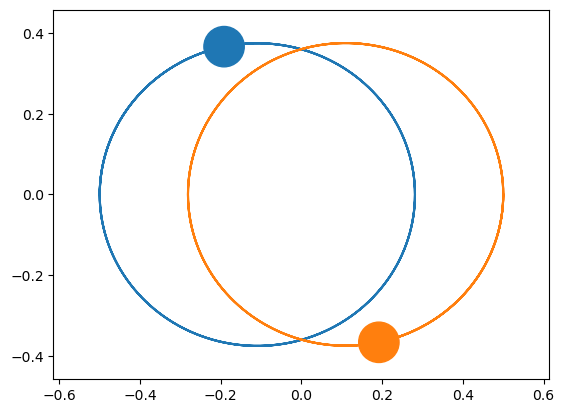

In [27]:
s1 = Ball(r=(-0.5,0), v=(0, 0.6))
s2 = Ball(r=(0.5,0), v=(0, -0.6))
kepler_two_star(t_max=10, num_step=10000, star1=s1, star2=s2)
s1.pos_list = np.array(s1.pos_list)
s1.pos_x = s1.pos_list[:,0]
s1.pos_y = s1.pos_list[:,1]
s1.shape = plt.Circle((s1.pos_x[-1], s1.pos_y[-1]), radius=0.05, color='tab:blue')

s2.pos_list = np.array(s2.pos_list)
s2.pos_x = s2.pos_list[:,0]
s2.pos_y = s2.pos_list[:,1]
s2.shape = plt.Circle((s2.pos_x[-1], s2.pos_y[-1]), radius=0.05, color='tab:orange')

fig, ax = plt.subplots()
plt.plot(s1.pos_x, s1.pos_y)
plt.plot(s2.pos_x, s2.pos_y)
ax.add_patch(s1.shape)
ax.add_patch(s2.shape)

plt.axis('equal')



In [28]:
def draw_frame(frame_index):
    step = 50*frame_index
    s1.shape.set_center((s1.pos_x[step], s1.pos_y[step]))
    s2.shape.set_center((s2.pos_x[step], s2.pos_y[step]))

In [29]:
anim = animation.FuncAnimation(fig, draw_frame, frames=200, interval=20)
IPython.display.HTML(anim.to_jshtml())

---

## From two-body to N-body
<img src='https://github.com/slxuphys/tamu_phys_150/blob/master/gallery/many_body_force.png?raw=true' style='height:500px' height=500>

Total force on the ith ball
$$
\vec F_i = -\sum_{j, j\neq i} \frac{k}{\Delta r_{ij}^3} (\vec r_i -\vec r_j)
$$
Total acceleration of the ith ball
$$
\vec a_i = -\frac{1}{m_i}\sum_{j, j\neq i} \frac{k}{\Delta r_{ij}^3} (\vec r_i -\vec r_j)
$$


In [30]:
def kepler_many_star(t_max, num_step, star_list):
    dt = t_max/num_step
    for i in range(num_step):
        for si in star_list:
            si.a=0
            for sj in star_list:
                if si is sj: #si and sj are the same star, no self attraction 
                    continue
                dr = np.linalg.norm(si.r - sj.r)
                si.a = si.a + (-1)*(si.r - sj.r)/dr**3
        
        for s in star_list:
            s.move(dt)
            s.record()

### three body problem

Aliens living in a three star systems faces distinction and tries to invade solar system, a single star system.

![image](https://images.radio.com/aiu-media/3BodyProblem-9d3f5b50-eb56-4e15-ba64-8823286f66ef.jpg?width=800)

(-0.5499889891770833,
 0.5499889804965278,
 -0.27302639546669877,
 0.4163539554207002)

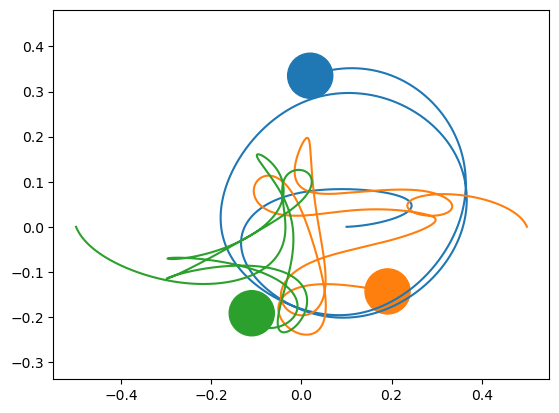

In [31]:
s1 = Ball(r=(0.1,0.0),v=(0.0,-0))
s2 = Ball(r=(0.5,0), v=(-0.2,0.5))
s3 = Ball(r=(-0.5,0), v=(0.2,-0.5))
slist= (s1, s2, s3)
kepler_many_star(t_max=2, num_step=40000, star_list=slist)

fig, ax = plt.subplots()
for s in slist:
    s.pos_list = np.array(s.pos_list)
    s.pos_x = s.pos_list[:,0]
    s.pos_y = s.pos_list[:,1]
    s.traj = plt.plot(s.pos_x, s.pos_y)[0] # get the line object being plotted

    s.shape = plt.Circle((s.pos_x[-1], s.pos_y[-1]), radius=0.05, color = s.traj.get_color())
    ax.add_patch(s.shape)

ax.axis('equal')

In [32]:
def draw_frame(frame_index):
    step = 200*frame_index
    for s in slist:
        s.shape.set_center((s.pos_x[step], s.pos_y[step]))

anim = animation.FuncAnimation(fig, draw_frame, frames=200, interval=20)
IPython.display.HTML(anim.to_jshtml())

Now try a different initial condition

(-1.2042443410982586,
 1.1898536182711312,
 -0.4120493473437195,
 0.3947711206404826)

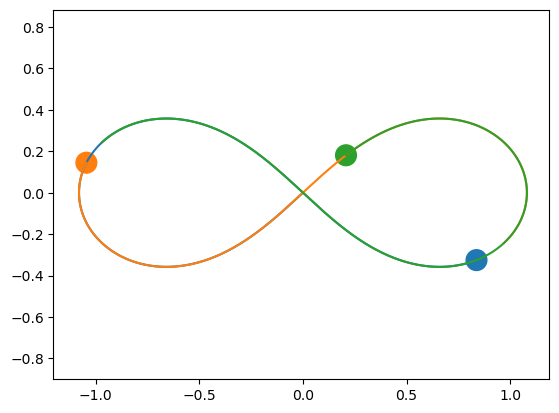

In [33]:
s1 = Ball(r=(0.0,0.0),v=(-0.93240737,-0.86473146))
s2 = Ball(r=(0.97000436,-0.24308753), v=(0.93240737/2,0.86473146/2))
s3 = Ball(r=(-0.97000436,0.24308753), v=(0.93240737/2,0.86473146/2))

slist= (s1, s2, s3)
kepler_many_star(t_max=4, num_step=40000, star_list=slist)

fig, ax = plt.subplots()
for s in slist:
    s.pos_list = np.array(s.pos_list)
    s.pos_x = s.pos_list[:,0]
    s.pos_y = s.pos_list[:,1]
    s.traj = plt.plot(s.pos_x, s.pos_y)[0]

    s.shape = plt.Circle((s.pos_x[-1], s.pos_y[-1]), radius=0.05, color = s.traj.get_color())
    ax.add_patch(s.shape)

ax.axis('equal')

In [34]:
def draw_frame(frame_index):
    step = 200*frame_index
    for s in slist:
        s.shape.set_center((s.pos_x[step], s.pos_y[step]))

anim = animation.FuncAnimation(fig, draw_frame, frames=200, interval=20)
IPython.display.HTML(anim.to_jshtml())


For fine tuned initial positions and velocities, the three stars can move in periodic orbitals, though not stable.


<img src='https://upload.wikimedia.org/wikipedia/commons/5/5a/5_4_800_36_downscaled.gif'>

By <a href="//commons.wikimedia.org/w/index.php?title=User:Perossello&amp;action=edit&amp;redlink=1" class="new" title="User:Perossello (page does not exist)">Perosello</a> - <a rel="nofollow" class="external text" href="https://x.com/PeRossello/status/1670803430544142338?s=20">Uploaded by Author</a>, <a href="https://creativecommons.org/licenses/by-sa/4.0" title="Creative Commons Attribution-Share Alike 4.0">CC BY-SA 4.0</a>, <a href="https://commons.wikimedia.org/w/index.php?curid=133294338">Link</a>

Also see: https://staff.aist.go.jp/k.koide/workspace/threebody/index.html